# Hierarchical clustering

## Imports

In [1]:
import sys
import scipy as sc
from scipy import stats
import numpy as np
import pandas as pd
import datetime as dt
import math
import pickle
import scipy.cluster.hierarchy as shc
from tqdm import tqdm
from alignment.sequencealigner import SimpleScoring, GlobalSequenceAligner
from alignment.vocabulary import Vocabulary
from alignment.sequence import Sequence


sys.setrecursionlimit(5000000)


## Variables

In [2]:
# Clustering parameters
number_of_stays = 3
start_index = 0
display_matrix = False

# File export suffix
file_suffix = '_real_'+ str(number_of_stays)

## Load datasets


### Load full dataset

In [8]:
# complete_data = pd.read_csv('../backend/static/complete_data_v1.7.csv', low_memory=False, index_col=[0])
complete_data = get_pickle('./complete_data_cleaned_v1')

In [9]:
data = complete_data

In [4]:
binned_data = pd.read_csv('../scripts/dataset_files/icu_binned_v2.csv', index_col=0)

/var/folders/lk/50s6d7zj3ml029c5x4nygd740000gn/T/ipykernel_2136/3900973096.py:1: DtypeWarning: Columns (7,9) have mixed types. Specify dtype option on import or set low_memory=False.
  binned_data = pd.read_csv('../scripts/dataset_files/icu_binned_v2.csv', index_col=0)


In [15]:
# complete_data.head()

,dicom_id,subject_id,study_id,PerformedProcedureStepDescription,ViewPosition,StudyDate,StudyTime,ProcedureCodeSequence_CodeMeaning,ViewCodeSequence_CodeMeaning,PatientOrientationCodeSequence_CodeMeaning,...,linksto,category,param_type,lownormalvalue,highnormalvalue,transfer_id,eventtype,careunit,intime,outtime
4,68b5c4b1-227d0485-9cc38c3f-7b84ab51-4b472714,10000032,53911762.0,CHEST (PORTABLE AP),AP,21800723.0,80556.875,CHEST (PORTABLE AP),antero-posterior,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,fffabebf-74fd3a1f-673b6b41-96ec0ac9-2ab69818,10000032,53911762.0,CHEST (PORTABLE AP),AP,21800723.0,80556.875,CHEST (PORTABLE AP),antero-posterior,Erect,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
27,943486a3-b3fa9ff7-50f5a769-7a62fcbb-f39b6da4,10000980,51967283.0,CHEST (PORTABLE AP),AP,21890627.0,64348.484,CHEST (PORTABLE AP),antero-posterior,Erect,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
54,a917c883-720a5bbf-02c84fc6-98ad00ac-c562ff80,10001217,52067803.0,CHEST (PA AND LAT),PA,21571118.0,185118.703,CHEST (PA AND LAT),postero-anterior,Erect,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
55,ab111843-fd3b8873-93d8943f-d7618a0c-e6674193,10001217,52067803.0,CHEST (PA AND LAT),LATERAL,21571118.0,185118.703,CHEST (PA AND LAT),lateral,Erect,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
complete_data = get_pickle('complete_data_v1.7')


In [9]:
complete_data.head()

,dicom_id,subject_id,study_id,PerformedProcedureStepDescription,ViewPosition,StudyDate,StudyTime,ProcedureCodeSequence_CodeMeaning,ViewCodeSequence_CodeMeaning,PatientOrientationCodeSequence_CodeMeaning,...,linksto,category,param_type,lownormalvalue,highnormalvalue,transfer_id,eventtype,careunit,intime,outtime
0,68b5c4b1-227d0485-9cc38c3f-7b84ab51-4b472714,10000032,53911762.0,CHEST (PORTABLE AP),AP,21800723.0,80556.875,CHEST (PORTABLE AP),antero-posterior,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,fffabebf-74fd3a1f-673b6b41-96ec0ac9-2ab69818,10000032,53911762.0,CHEST (PORTABLE AP),AP,21800723.0,80556.875,CHEST (PORTABLE AP),antero-posterior,Erect,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,943486a3-b3fa9ff7-50f5a769-7a62fcbb-f39b6da4,10000980,51967283.0,CHEST (PORTABLE AP),AP,21890627.0,64348.484,CHEST (PORTABLE AP),antero-posterior,Erect,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,a917c883-720a5bbf-02c84fc6-98ad00ac-c562ff80,10001217,52067803.0,CHEST (PA AND LAT),PA,21571118.0,185118.703,CHEST (PA AND LAT),postero-anterior,Erect,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,ab111843-fd3b8873-93d8943f-d7618a0c-e6674193,10001217,52067803.0,CHEST (PA AND LAT),LATERAL,21571118.0,185118.703,CHEST (PA AND LAT),lateral,Erect,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
save_as_pickle(complete_data, 'complete_data_v1.7')


### Add ID to events

In [7]:
data.insert(0, 'event_id', range(0, len(data)))


NameError: name 'data' is not defined

### Load individual datasets

In [5]:
metadata = pd.read_csv('./csv/mimic-cxr-2.0.0-metadata.csv')
# icu = pd.read_csv('./csv/first_6000_patients.csv')
all_stays = pd.read_csv('./csv/all_stays.csv')

all_stays['charttime'] = pd.to_datetime(all_stays['intime'])
# icu['charttime'] = pd.to_datetime(icu['charttime'], format='%Y-%m-%d')


In [16]:
data = get_pickle('icu_binned_v1')
icu_binned = data

In [20]:
nan_vals = icu_binned[icu_binned['value_encoded'] == -1]
nan_vals.head()

,event_id,subject_id,hadm_id,stay_id,charttime,storetime,itemid,value,valuenum,valueuom,warning,label,abbreviation,linksto,category,param_type,lownormalvalue,highnormalvalue,value_categorical,value_encoded
9,15807,10582595,20690213,33235984,2110-02-09 21:46:00,2110-02-09 21:51:00,225090,No,NaN,NaN,0,Interpreter,Interpreter,chartevents,Adm History/FHPA,Text,NaN,NaN,NaN,-1
288,15808,10582595,20690213,33235984,2110-02-10 02:47:00,2110-02-10 02:49:00,225090,No,NaN,NaN,0,Interpreter,Interpreter,chartevents,Adm History/FHPA,Text,NaN,NaN,NaN,-1
2597,15809,10582595,20690213,33235984,2110-02-12 03:32:00,2110-02-12 03:32:00,225090,No,NaN,NaN,0,Interpreter,Interpreter,chartevents,Adm History/FHPA,Text,NaN,NaN,NaN,-1
3627,15810,10582595,20690213,33235984,2110-02-13 03:00:00,2110-02-13 03:01:00,225090,No,NaN,NaN,0,Interpreter,Interpreter,chartevents,Adm History/FHPA,Text,NaN,NaN,NaN,-1
16436,15811,10168722,25403630,32404106,2110-11-14 22:14:00,2110-11-14 22:22:00,225090,No,NaN,NaN,0,Interpreter,Interpreter,chartevents,Adm History/FHPA,Text,NaN,NaN,NaN,-1


In [22]:
nan_list = list(nan_vals['label'].unique())
len(nan_list)

1119

In [30]:
nan_vals.to_csv('labels_null.csv')

## Data preprocessing

In [11]:
labels = list(icu['label'].unique())

In [12]:
def freedman_diaconis(data):
    """
    Use Freedman Diaconis rule to compute optimal histogram bin width. 
    ``returnas`` can be one of "width" or "bins", indicating whether
    the bin width or number of bins should be returned respectively. 


    Parameters
    ----------
    data: np.ndarray
        One-dimensional array.

    returnas: {"width", "bins"}
        If "width", return the estimated width for each histogram bin. 
        If "bins", return the number of bins suggested by rule.
    """
    data = np.asarray(data, dtype=np.float_)
    IQR = stats.iqr(data, rng=(25, 75), scale="raw", nan_policy="omit")
    N = data.size
    bw = max((2 * IQR) / np.power(N, 1/3), 1)

    datmin, datmax = data.min(), data.max()
    datrng = datmax - datmin
    # if bw == 0:
    #   print(f'Error: IQR: {IQR}, N: {N}, pow: {np.power(N,1/3)}, bw: {bw}, datmax: {datmax}, datmin: {datmin}')
    bins = int((datrng / bw) + 1)

    return bw, bins

In [13]:
def binned_data(data, width, num_bins):
  if np.isnan(width) or np.isnan(num_bins):
    raise Exception(f'Width or num_bins is not a number')

  binned_values = []

  for value in data:
    bin_index = math.floor(value/width)
    binned_values.append(f'({bin_index * width}, {(bin_index+1) * width }]')

  return binned_values

In [ ]:
icu_binned = pd.DataFrame()
blacklist = []

for label in labels:
  # print(label)
  values = icu[icu['label'] == label]
  val_type = list(values['param_type'])

  if (label in blacklist):
    continue

  if not ('Text' in val_type or 'Checkbox' in val_type):
    IQR = stats.iqr(values['valuenum'], rng=(
        25, 75), scale="raw", nan_policy="omit")

    # If value has IQR of 0, we blacklist it
    # if IQR == 0:
    #   blacklist.append(label)
    #   continue;

    width, bins = freedman_diaconis(values['valuenum'])
    values['value_categorical'] = binned_data(values['valuenum'], width, bins)
  elif('Checkbox' in val_type):
    values['value_categorical'] = binned_data(values['valuenum'], 1, 2)

  icu_binned = pd.concat([icu_binned, values])

In [15]:
text_df = icu[icu['param_type'] == "Text"]
text_labels = list(text_df['label'].unique())
text_df['value'] = text_df['value'].astype('category')
text_df["value_categorical"] = text_df["value"].cat.codes

/var/folders/lk/50s6d7zj3ml029c5x4nygd740000gn/T/ipykernel_6296/4126498665.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  text_df['value'] = text_df['value'].astype('category')
/var/folders/lk/50s6d7zj3ml029c5x4nygd740000gn/T/ipykernel_6296/4126498665.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  text_df["value_categorical"] = text_df["value"].cat.codes


In [16]:
icu_binned = pd.concat([icu_binned, text_df])

In [ ]:
icu_binned['value_categorical'] = icu_binned['value_categorical'].astype('category')
icu_binned['value_encoded'] = icu_binned['value_categorical'].cat.codes

In [22]:
save_as_pickle(icu_binned, 'icu_binned_v1')

## Cluster data

### Compute distance list

In [14]:
data.columns

Index(['subject_id', 'hadm_id', 'stay_id', 'charttime', 'storetime', 'itemid',
       'value', 'valuenum', 'valueuom', 'warning', 'label', 'abbreviation',
       'linksto', 'category', 'param_type', 'lownormalvalue',
       'highnormalvalue', 'value_categorical', 'study_id',
       'PerformedProcedureStepDescription', 'ViewPosition', 'Rows', 'Columns',
       'StudyDate', 'StudyTime', 'ProcedureCodeSequence_CodeMeaning',
       'ViewCodeSequence_CodeMeaning',
       'PatientOrientationCodeSequence_CodeMeaning', 'transfer_id',
       'eventtype', 'careunit', 'intime', 'outtime'],
      dtype='object')

In [11]:
stays = list(data['hadm_id'].unique())[start_index: start_index + number_of_stays]
distances = []
print(stays)

for y in tqdm(range(len(stays))):
  sequence_y = data[data['hadm_id'] == stays[y]]
  distance_row = []
  print(f"sequence: {sequence_y}")

#   for x in tqdm(range(y, len(stays))):
#     sequence_x = data[data['hadm_id'] == stays[x]]


#     # Diagonal
#     if stays[y] == stays[x]:
#       distance_row.append(0)
#       continue
#     else:
#       len_x, len_y = len(sequence_x), len(sequence_y)
#       max_seq_length = max(len_x, len_y)
#       index, distance = 0, 0

#       while (index != max_seq_length):
#         # Check if index is out of bounds for a stay, if so, add length to distance 
#         if (index >= len_x) or (index >= len_y):
#           distance += (max_seq_length - index)    # distance measure dependent
#           break
#         else:
#           # Add 1 to distance if the event is not the same
#           if sequence_x.iloc[index]['value_categorical'] != sequence_y.iloc[index]['value_categorical']:
#             distance += 1     # distance measure dependent
#           # if sequence_x.iloc[index]['careunit'] != sequence_y.iloc[index]['careunit']:
#           #   distance += 1     # distance measure dependent
          
#           index += 1
#     distance_row.append(distance)
#   distances.append(distance_row)


# print(distances)
# if display_matrix:
#   print('Computed distance matrix:')

#   for line in distances:
#     print ('  '.join(map(str, line)))

[20690213.0, 25328682.0, 21586668.0]


100%|██████████| 3/3 [00:00<00:00,  7.70it/s]

sequence:       subject_id     hadm_id     stay_id           charttime  \
0       10582595  20690213.0  33235984.0 2110-02-09 20:42:00   
1       10582595  20690213.0  39041457.0 2110-02-09 20:42:00   
2       10582595  20690213.0  39041457.0 2110-02-09 20:42:00   
3       10582595  20690213.0  33235984.0 2110-02-09 21:46:00   
295     10582595  20690213.0  33235984.0 2110-02-10 02:47:00   
...          ...         ...         ...                 ...   
7222    10582595  20690213.0  39041457.0 2110-02-16 12:44:00   
7223    10582595  20690213.0  39041457.0 2110-02-16 12:44:00   
7224    10582595  20690213.0  39041457.0 2110-02-16 12:44:00   
7225    10582595  20690213.0  39041457.0 2110-02-16 12:44:00   
7226    10582595  20690213.0  39041457.0 2110-02-16 12:44:00   

                storetime    itemid         value  valuenum valueuom  warning  \
0     2110-02-10 16:45:00  226512.0          54.3      54.3       kg      0.0   
1     2110-02-16 12:11:00  226730.0         163.0     163.0

In [34]:
def get_sequence_distance_list(u,v):
  index_u, index_v = stays.index(u[0]), stays.index(v[0])
  return distances[min(index_u, index_v)][max(index_u,index_v) - min(index_u,index_v)]

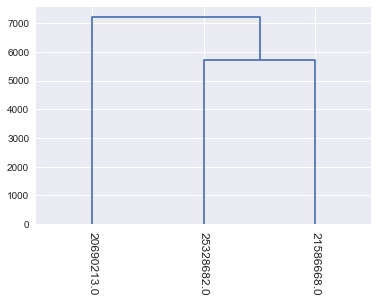

In [99]:
lackeys = data.drop_duplicates(subset=['hadm_id'])[
    start_index: start_index + number_of_stays]
# lackeys = lackeys.drop(columns=['subject_id', 'transfer_id','eventtype', 'careunit', 'intime', 'outtime', 'charttime'])
lackeys = lackeys.drop(columns=['subject_id', 'stay_id', 'charttime', 'storetime', 'itemid',
                                'value', 'valuenum', 'valueuom', 'warning', 'label', 'abbreviation',
                                'linksto', 'category', 'param_type', 'lownormalvalue',
                                'highnormalvalue', 'value_categorical', 'study_id',
                                'PerformedProcedureStepDescription', 'ViewPosition', 'Rows', 'Columns',
                                'StudyDate', 'StudyTime', 'ProcedureCodeSequence_CodeMeaning',
                                'ViewCodeSequence_CodeMeaning',
                                'PatientOrientationCodeSequence_CodeMeaning', 'transfer_id',
                                'eventtype', 'careunit', 'intime', 'outtime'])
links = shc.linkage(lackeys, metric=get_sequence_distance_list)
dend = shc.dendrogram(links, labels=stays, leaf_rotation=-90)

In [86]:
branch_depths = [0]
for d in dend['dcoord']:
    branch_depths.append(d[1])
branch_depths

alignments = {}
for branch_depth in tqdm(branch_depths):
    # Calculate sequence alignment
    # print(f'Aligning sequences on level: {branch_depth}')
    alignments[branch_depth] = cluster_events(branch_depth, data, stays, links)

# alignments


100%|██████████| 2/2 [00:57<00:00, 28.90s/it]

Edit distance is length: 8587


In [12]:
save_as_pickle(alignments, 'alignments' + file_suffix)

In [54]:
clusters = list(shc.fcluster(links, t=1098.0, criterion="distance"))

print(clusters)
print(stays)
print(f'Max level: {max(shc.maxdists(links))}')


[8, 6, 1, 3, 2, 9, 7, 4, 5, 1]
[20690213, 25328682, 21586668, 27896354, 25403630, 20895291, 22090317, 21011057, 28206315, 23586251]
Max level: 19212.0


In [13]:
save_as_pickle(links, 'links' + file_suffix)
save_as_pickle(distances, 'dist_matrix' + file_suffix)
save_as_pickle(stays, 'stays' + file_suffix)
save_as_pickle(data[data['hadm_id'].isin(stays)], 'events' + file_suffix)

### Get aligned sequences

In [ ]:
clustered = cluster_events(9638, data, stays, links)


## Event types

In [10]:
print(data.columns)
data.head()

Index(['subject_id', 'hadm_id', 'stay_id', 'charttime', 'storetime', 'itemid',
       'value', 'valuenum', 'valueuom', 'warning', 'label', 'abbreviation',
       'linksto', 'category', 'param_type', 'lownormalvalue',
       'highnormalvalue', 'value_categorical', 'study_id',
       'PerformedProcedureStepDescription', 'ViewPosition', 'Rows', 'Columns',
       'StudyDate', 'StudyTime', 'ProcedureCodeSequence_CodeMeaning',
       'ViewCodeSequence_CodeMeaning',
       'PatientOrientationCodeSequence_CodeMeaning', 'transfer_id',
       'eventtype', 'careunit', 'intime', 'outtime'],
      dtype='object')


,subject_id,hadm_id,stay_id,charttime,storetime,itemid,value,valuenum,valueuom,warning,...,StudyDate,StudyTime,ProcedureCodeSequence_CodeMeaning,ViewCodeSequence_CodeMeaning,PatientOrientationCodeSequence_CodeMeaning,transfer_id,eventtype,careunit,intime,outtime
0,10582595,20690213.0,33235984.0,2110-02-09 20:42:00,2110-02-10 16:45:00,226512.0,54.3,54.3,kg,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7227,10264572,25328682.0,34149732.0,2110-02-17 01:40:00,2110-02-17 03:45:00,226512.0,78.0,78.0,kg,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12934,10617255,21586668.0,37228716.0,2110-06-17 23:30:00,2110-06-18 01:14:00,226512.0,61.1,61.1,kg,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13690,10499563,27896354.0,32084946.0,2110-11-09 06:30:00,2110-11-09 07:30:00,226512.0,128.0,128.0,kg,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16190,10168722,25403630.0,32404106.0,2110-11-14 18:21:00,2110-11-14 21:18:00,226512.0,53.6,53.6,kg,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [50]:
data_subset = data[['value', 'valueuom', 'label',
                         'param_type', 'value_categorical', 'PerformedProcedureStepDescription', 'careunit', 'eventtype', 'intime', 'outtime']]
data_subset.set_index('value_categorical')
data_subset.sort_values(by='value_categorical')
data_subset.head()


,value,valueuom,label,param_type,value_categorical,PerformedProcedureStepDescription,careunit,eventtype,intime,outtime
0,54.3,kg,Admission Weight (Kg),Numeric,955,NaN,NaN,NaN,NaN,NaN
7227,78.0,kg,Admission Weight (Kg),Numeric,960,NaN,NaN,NaN,NaN,NaN
12934,61.1,kg,Admission Weight (Kg),Numeric,956,NaN,NaN,NaN,NaN,NaN
13690,128.0,kg,Admission Weight (Kg),Numeric,927,NaN,NaN,NaN,NaN,NaN
16190,53.6,kg,Admission Weight (Kg),Numeric,954,NaN,NaN,NaN,NaN,NaN


In [24]:
test = data[data['label'] == '14 G Infiltration Scale'].drop_duplicates()
test
vals = [{'value': v.value, 'value_unit': v.valueuom if not pd.isnull(v.valueuom) else -1, 'value_cat': v.value_categorical,
         'value_enc': v.value_categorical, } for v in test.itertuples(index=True)]
print(vals)


[{'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 'value_cat': 10505, 'value_enc': 10505}, {'value': 'Grade 0', 'value_unit': -1, 

In [9]:
labels = []

total_unique_labels = []

# total_unique_labels.append(data['label'].unique())
# total_unique_labels.append(data['careunit'].unique())
# total_unique_labels.append(data['PerformedProcedureStepDescription'].unique());


for care_unit in tqdm(data['careunit'].unique()):
    values = data[data['careunit'] == care_unit].drop_duplicates()
    label = {
        'type': 'Transfer',
        'care_unit': care_unit,
        'values': [{'event_type' : v.eventtype, 'value_enc': v.value_categorical} for v in values.itertuples(index=True)]
    }
    labels.append(label)
    
for photo_description in tqdm(data['ProcedureCodeSequence_CodeMeaning'].unique()):
    values = data[data['ProcedureCodeSequence_CodeMeaning']
                  == photo_description]
    label = {
        'type': 'Photo',
        'viewpoint': photo_description,
        'values': [{'view_position': v.ViewPosition, 'patient_orientation': v.PatientOrientationCodeSequence_CodeMeaning, 'value_enc': v.value_categorical} for v in values.itertuples(index=True)]

    }
    labels.append(label)
    
for label in tqdm(data['label'].unique()):
    values = data[data['label'] == label].drop_duplicates()
    label = {
        'type': 'ICU measurement',
        'measurement': label,
        'values': [{'value': v.value, 'value_unit': v.valueuom if not pd.isnull(v.valueuom) else -1, 'value_enc': v.value_categorical, } for v in values.itertuples(index=True)]
    }
    labels.append(label)
    
    
labels

100%|██████████| 1718/1718 [17:40<00:00,  1.62it/s] 


[{'type': 'Transfer', 'care_unit': nan, 'values': []},
 {'type': 'Transfer',
  'care_unit': 'Emergency Department',
  'values': [{'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': 'ED', 'value_enc': 10524},
   {'event_type': '

In [4]:
changed = False

if 'care_unit' in labels[0] and (type(labels[0]['care_unit']) == 'int' and math.isnan(labels[0]['care_unit'])):
    labels[0]['care_unit'] = 'Not available'
    print(labels[0])
    changed = True

if 'measurement' in labels[len(labels) - 1] and type(labels[len(labels) - 1]) == 'int' and math.isnan(labels[len(labels) - 1]['measurement']):
    labels[len(labels) - 1]['measurement'] = "Not available"
    print(labels[len(labels) - 1])
    changed = True


for i in range(0, len(labels)):
    if ('type' in labels[i]) and (labels[i]['type'] == 'Photo') and (not isinstance(labels[i]['viewpoint'], str)):
        labels[i]['viewpoint'] = 'Not available'
        print(labels[i])
        changed = True


if changed:
    print('saving...')
    save_as_pickle(labels, 'labels')


NameError: name 'labels' is not defined

In [12]:
save_as_pickle(labels, 'labels')


## Functions

### Load Pickle file

In [6]:
def get_pickle(file_name):
    return pickle.load(open(file_name, 'rb'))

### Store data as Pickle

In [7]:
def save_as_pickle(data, file_name):
    file = open(file_name, 'wb')
    pickle.dump(data, file)
    file.close()
    

In [29]:
data.columns

Index(['subject_id', 'hadm_id', 'stay_id', 'charttime', 'storetime', 'itemid',
       'value', 'valuenum', 'valueuom', 'warning', 'label', 'abbreviation',
       'linksto', 'category', 'param_type', 'lownormalvalue',
       'highnormalvalue', 'value_categorical', 'study_id',
       'PerformedProcedureStepDescription', 'ViewPosition', 'Rows', 'Columns',
       'StudyDate', 'StudyTime', 'ProcedureCodeSequence_CodeMeaning',
       'ViewCodeSequence_CodeMeaning',
       'PatientOrientationCodeSequence_CodeMeaning', 'transfer_id',
       'eventtype', 'careunit', 'intime', 'outtime'],
      dtype='object')

### Align functions

In [89]:
def cluster_events(level, events, stays, links):
    clusters = get_clusters_by_level(level, links)
    unique_levels = list(set(clusters))
    stays_per_cluster = list(
        zip(clusters, [np.int64(a).item() for a in stays]))

    levels = []

    for count, level in enumerate(unique_levels):
        indices = list(
            filter(lambda x: clusters[x] == level, range(len(clusters))))
        matched_sequences = []
        matched_sequences_2 = []

        for index in indices:
            temp = events[events['hadm_id'] == stays[index]]
            # sequence = {
            #     'id': stays[index],
            #     'events': [],
            # }
            matched_sequences.append(
                ' '.join(map(str, temp['value_categorical'].tolist())))
            matched_sequences_2.append(temp['value_categorical'].tolist())
            # for index, event in temp.iterrows():
            #     sequence['events'].append({
            #         'id':  event.event_id,
            #         'event': event.value_encoded,
            #         'stay': event.hadm_id
            #     })
            # matched_sequences.append(sequence)

            # for event in temp:
            #     print(f'event: {event.event_id}')
            #     matched_sequences.append({
            #         'id':  event['event_id'],
            #         'event': event['value_encoded'].tolist()
            #     })
            # matched_sequences.append(
            #     ' '.join(map(str, temp['value_encoded'].tolist())))
                        
        level_object = {
            'level': np.int64(level).item(),
            'aggregated': len(matched_sequences) > 1
        }

        if len(matched_sequences) > 1:
            # level_object['sequence'] = get_alignments(matched_sequences)
            level_object['sequence'] = get_alignments_2(matched_sequences_2)
            # level_object['sequence'] = get_alignments(
            #     matched_sequences, stays_per_cluster[level - 1][1])
            # level_object['sequence'] = get_alignments(
            #     matched_sequences, stays_per_cluster[level - 1][1])

        else:
            # level_object['sequence'] = {'id': stays_per_cluster[level - 1][1], 'events': matched_sequences}
            level_object['sequence'] = list(map(int, matched_sequences[0].split(' ')))
            # level_object['sequence'] = {'id': stays_per_cluster[level - 1][1], 'events': list(
            #     map(int, matched_sequences[0].split(' ')))}

        level_object['stays'] = [k[1]
                                 for k in stays_per_cluster if k[0] == level]
        level_object['stay'] = level_object['stays'][0]
        levels.append(level_object)

    return levels


def get_clusters_by_level(level, links):
    return list(shc.fcluster(links, t=level, criterion="distance"))

def get_alignments_2(clustered_sequences):
    sequences = []
    
    a = clustered_sequences[0]
    
    for i in range (1, len(clustered_sequences)):
        b = clustered_sequences[i]
    
        sm = SequenceMatcher(a=a, b=b, action_function=ed.highest_match_action)
        
    
        
        
        print(f"Edit distance is length: {sm.distance()}")

    return sequences
# print(sm.get_opcodes())
# # print(sm.ratio())
# print(sm.get_matching_blocks())
# print(list(sm.get_matching_blocks()))
# print(sm.distance())
# print(sm.matches())
    


def get_alignments(clustered_sequences):
    v = Vocabulary()
    a = Sequence(clustered_sequences[0].split())
    a_encoded = v.encodeSequence(a)
    
    sequence = []
    
    for i in range(1, len(clustered_sequences)):
        b = Sequence(clustered_sequences[i].split())
        # b = Sequence(" ".join(
        #     map(str, list(map(lambda x: x["event"], clustered_sequences[i]["events"])))))
        b_encoded = v.encodeSequence(b)
        scoring = SimpleScoring(2, -1)
        aligner = GlobalSequenceAligner(scoring, -2)
        score, encodeds = aligner.align(a_encoded, b_encoded, backtrace=True)

        print(f'encodeds: {encodeds}')

        for encoded in encodeds:
            alignment = v.decodeSequenceAlignment(encoded)
            aligned_sequences = [i.split()
                                 for i in str(alignment).splitlines()]

            for j in range(len(aligned_sequences[0])):
                if j == len(sequence):
                    # element should be added as this does not occur yet
                    if aligned_sequences[0][j] == aligned_sequences[1][j]:
                        # equal
                        # sequence.append({
                        #     'id' : 0,
                        #     'event': aligned_sequences[0][j]
                        # })
                        sequence.append([aligned_sequences[0][j]])
                    else:
                        # different
                        sequence.append([aligned_sequences[0][j],
                                         aligned_sequences[1][j]])
                        # sequence.append({
                        #     'id': 0,
                        #     'event': aligned_sequences[0][j]
                        # })
                        # sequence.append({
                        #     'id': 0,
                        #     'event': aligned_sequences[1][j]
                        # })
                else:
                    if aligned_sequences[0][j] == aligned_sequences[1][j]:
                        # equal
                        # sequence[j].append({
                        #     'id': 0,
                        #     'event': aligned_sequences[0][j]
                        # })
                        sequence[j].extend([aligned_sequences[0][j]])

                    else:
                        # different
                        sequence[j].extend([aligned_sequences[0][j],
                                            aligned_sequences[1][j]])
                        # sequence[j].append({
                        #     'id': 0,
                        #     'event': aligned_sequences[0][j]
                        # })
                        # sequence[j].append({
                        #     'id': 0,
                        #     'event': aligned_sequences[1][j]
                        # })                

    sequence = [list(set(i)) for i in sequence]
    sequence = [i if len(i) > 1 else int(i[0])
                for i in sequence]
    return sequence
    # return {'id': stays, 'sequence': sequence}


In [158]:
for item in alignments.keys():
    for index, item in enumerate(alignments[item]):
        
        item['id'] = index

In [81]:
alignments[0][0].keys()

dict_keys(['level', 'aggregated', 'sequence', 'stays', 'id'])

In [82]:
save_as_pickle(alignments, 'alignments_id_real_10')


## Data summary

In [14]:
list(data.columns)

['subject_id',
 'hadm_id',
 'stay_id',
 'charttime',
 'storetime',
 'itemid',
 'value',
 'valuenum',
 'valueuom',
 'warning',
 'label',
 'abbreviation',
 'linksto',
 'category',
 'param_type',
 'lownormalvalue',
 'highnormalvalue',
 'value_categorical',
 'study_id',
 'PerformedProcedureStepDescription',
 'ViewPosition',
 'Rows',
 'Columns',
 'StudyDate',
 'StudyTime',
 'ProcedureCodeSequence_CodeMeaning',
 'ViewCodeSequence_CodeMeaning',
 'PatientOrientationCodeSequence_CodeMeaning',
 'transfer_id',
 'eventtype',
 'careunit',
 'intime',
 'outtime']

In [20]:
icu_len = len(list(data['label'].unique()))
transfer_len = len(list(data['careunit'].unique()))
photo_len = len(list(data['PatientOrientationCodeSequence_CodeMeaning'].unique()))
print(f"Len icu: {icu_len}")
print(f"Len transfer: {transfer_len}")
print(f"Len photo: {photo_len}")
print(f"Len total: {icu_len + photo_len + transfer_len}")


Len icu: 1718
Len transfer: 26
Len photo: 3
Len total: 1747


In [102]:
# from alignment.sequence import Sequence
# from alignment.vocabulary import Vocabulary
# from alignment.sequencealigner import SimpleScoring, GlobalSequenceAligner

# Create sequences to be aligned.

a = Sequence('103 104 768 809'.split())
b = Sequence('103 104 809'.split())

# Create a vocabulary and encode the sequences.
v = Vocabulary()
aEncoded = v.encodeSequence(a)
bEncoded = v.encodeSequence(b)

# Create a scoring and align the sequences using global aligner.
scoring = SimpleScoring(2, -1)
aligner = GlobalSequenceAligner(scoring, -2)
score, encodeds = aligner.align(aEncoded, bEncoded, backtrace=True)

# Iterate over optimal alignments and print them.
for encoded in encodeds:
    alignment = v.decodeSequenceAlignment(encoded)
    print(f"{alignment}")
    print(f"Alignment score: {alignment.score}")
    print(f"Percent identity: {alignment.percentIdentity()}")


103 104 768 809
103 104 -   809
Alignment score: 4
Percent identity: 75.0


In [75]:
from  edit_distance import SequenceMatcher
import edit_distance as ed

In [79]:
ref = [1,2,3,4,5]
hyp = [1,2,7,4,5,6]
# sm = SequenceMatcher(a=ref, b=hyp)
sm = SequenceMatcher(a=ref, b=hyp, action_function=ed.highest_match_action)
print(sm.get_opcodes())
# print(sm.ratio())
print(sm.get_matching_blocks())
print(list(sm.get_matching_blocks()))
print(sm.distance())
print(sm.matches())

# [['equal', 0, 1, 0, 1], ['equal', 1, 2, 1, 2], ['insert', 1, 1, 2, 3], ['equal', 2, 3, 3, 4], ['delete', 3, 4, 3, 3], ['delete', 4, 5, 3, 3]]



[['equal', 0, 1, 0, 1], ['equal', 1, 2, 1, 2], ['replace', 2, 3, 2, 3], ['equal', 3, 4, 3, 4], ['equal', 4, 5, 4, 5], ['insert', 4, 4, 5, 6]]
[[0, 0, 1], [1, 1, 1], [3, 3, 1], [4, 4, 1]]
2
4


In [100]:
branch_depths = [0]
for d in dend['dcoord']:
    branch_depths.append(d[1])

print(f"BD: {branch_depths}")
alignments = {}

for branch_depth in tqdm(branch_depths):
    print(f"Current depth: {branch_depth}")
    # Calculate sequence alignment
    # print(f'Aligning sequences on level: {branch_depth}')
    # alignments[branch_depth] = cluster_events(branch_depth, data, stays, links)
    clusters = get_clusters_by_level(branch_depth, links)
    unique_levels = list(set(clusters))    
    stays_per_cluster = list(
        zip(clusters, [np.int64(a).item() for a in stays]))
    
    print(f"Clusters: {clusters}")
    print(f"Unique levels: {unique_levels}")
    print(f"Stays per cluster: {stays_per_cluster}")

    levels = []
    

alignments

# print(f"Clusters: {get_clusters_by_level(branch_depth[0], links)}")

BD: [0, 5706.0, 7208.0]


100%|██████████| 3/3 [00:00<00:00, 5271.43it/s]

Current depth: 0
Clusters: [3, 1, 2]
Unique levels: [1, 2, 3]
Stays per cluster: [(3, 20690213), (1, 25328682), (2, 21586668)]
Current depth: 5706.0
Clusters: [2, 1, 1]
Unique levels: [1, 2]
Stays per cluster: [(2, 20690213), (1, 25328682), (1, 21586668)]
Current depth: 7208.0
Clusters: [1, 1, 1]
Unique levels: [1]
Stays per cluster: [(1, 20690213), (1, 25328682), (1, 21586668)]


{}